In [ ]:
'''Crime in Chicago has been worrisome to the Chicago PD. Reported crimes have been tracked on a daily basis 
since 2001 and have been provided in the project data file. The Chicago PD would like to drastically reduce the
spate of violent crimes reported in the city. Being effective involves knowing crime patterns and where they are
likely to occur. It also involves equipping the Police Department appropriately. They have recruited you to
conduct full data analytics and uncover insights from the data that can be used to effectively prepare for and
respond to crimes. They are interested in gleaning any insights that can help them determine What type of
crimes to prepare for, Where these crimes are most likely to occur, What days of the week and periods to expect
these crimes.
'''
# Task
'''Conduct a complete data analytics study and from your analytics, advise the Chicago PD accordingly.'''

In [2]:
import pandas as pd  
import os
pd.set_option("display.max_rows", None) 

In [3]:
os.chdir('/Users/tomisin/Library/Mobile Documents/com~apple~CloudDocs/c.Documents/finalproject_DataAnalysis')

In [4]:
df = pd.read_csv('crime_data_Proj1.csv')

In [7]:
df = df.rename(columns = {'Unnamed: 0': 'Crime S/N','Primary Type': 'CrimeTyp', 'Location Description': 'CrimeLoc', 'Community Area':'CommArea', 'FBI Code': 'FBI'})

In [8]:
df.columns

Index(['Crime S/N', 'ID', 'Case Number', 'Date', 'Block', 'IUCR', 'CrimeTyp',
       'Description', 'CrimeLoc', 'Arrest', 'Domestic', 'Beat', 'District',
       'Ward', 'CommArea', 'FBI', 'X Coordinate', 'Y Coordinate', 'Year',
       'Updated On', 'Latitude', 'Longitude', 'Location'],
      dtype='object')

In [9]:
df.isna().sum()

Crime S/N            0
ID                   0
Case Number          1
Date                 0
Block                0
IUCR                 0
CrimeTyp             0
Description          0
CrimeLoc          2877
Arrest               0
Domestic             0
Beat                 0
District            12
Ward            184695
CommArea        184267
FBI                  0
X Coordinate     23985
Y Coordinate     23985
Year                 0
Updated On           0
Latitude         23985
Longitude        23985
Location         23985
dtype: int64

In [10]:
dfSub = df[['Crime S/N', 'ID', 'Date', 'Block',
       'CrimeTyp', 'Description', 'CrimeLoc', 'Arrest',
       'Domestic', 'District',  'Year', 'Updated On']]

In [11]:
dfSub = dfSub[0:20000]

In [12]:
dfSub.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Crime S/N    20000 non-null  int64  
 1   ID           20000 non-null  int64  
 2   Date         20000 non-null  object 
 3   Block        20000 non-null  object 
 4   CrimeTyp     20000 non-null  object 
 5   Description  20000 non-null  object 
 6   CrimeLoc     19974 non-null  object 
 7   Arrest       20000 non-null  bool   
 8   Domestic     20000 non-null  bool   
 9   District     20000 non-null  float64
 10  Year         20000 non-null  int64  
 11  Updated On   20000 non-null  object 
dtypes: bool(2), float64(1), int64(3), object(6)
memory usage: 1.6+ MB


In [13]:
from dateutil.parser import parse
from datetime import datetime


tCol = dfSub.Date

List = [(datetime.ctime(parse(x[0:-3])),x[-2:]) for x in tCol]
dayList = []
monthList = []
periodList = []
for row in List:
    day = row[0][0:4]
    month = row[0][4:7]
    if row[1]=='AM':
        period = 'Morning'
    elif row[1] =='PM' and int(row[0][11:13])<4:
        period = 'Afternoon'
    elif row[1] =='PM' and int(row[0][11:13])<6:
        period = 'Evening' 
    elif row[1] =='PM' and int(row[0][11:13])>5:
        period = 'Night'
    else:
        period = 'Unknown'
        
    dayList.append(day)
    monthList.append(month)
    periodList.append(period)
    
print(len(dayList), len(monthList), len(periodList))    

dfSub['month'] = monthList
dfSub['day'] = dayList
dfSub['period']= periodList
dfSub.head()

20000 20000 20000


,Crime S/N,ID,Date,Block,CrimeTyp,Description,CrimeLoc,Arrest,Domestic,District,Year,Updated On,month,day,period
0,0,6407111,07/26/2008 02:30:00 PM,085XX S MUSKEGON AVE,CRIMINAL DAMAGE,TO VEHICLE,STREET,False,False,4.0,2008,02/28/2018 03:56:25 PM,Jul,Sat,Afternoon
1,1,11398199,07/31/2018 10:57:00 AM,092XX S ELLIS AVE,WEAPONS VIOLATION,UNLAWFUL POSS AMMUNITION,POOL ROOM,True,False,4.0,2018,08/07/2018 04:02:59 PM,Jul,Tue,Morning
2,2,5488785,04/27/2007 10:30:00 AM,062XX N TRIPP AVE,BURGLARY,FORCIBLE ENTRY,RESIDENCE,True,False,17.0,2007,02/28/2018 03:56:25 PM,Apr,Fri,Morning
3,3,11389116,07/23/2018 08:55:00 AM,0000X N KEELER AVE,ASSAULT,SIMPLE,NURSING HOME/RETIREMENT HOME,False,False,11.0,2018,07/30/2018 03:52:24 PM,Jul,Mon,Morning
4,4,12420431,07/11/2021 06:40:00 AM,016XX W HARRISON ST,ASSAULT,AGGRAVATED - HANDGUN,PARKING LOT / GARAGE (NON RESIDENTIAL),False,False,12.0,2021,07/18/2021 04:56:02 PM,Jul,Sun,Morning


In [15]:
dfSub.day.unique()

array(['Sat ', 'Tue ', 'Fri ', 'Mon ', 'Sun ', 'Wed ', 'Thu '],
      dtype=object)

In [16]:
wkList = []
for day in list(dfSub.day):
    if day in ['Sat ', 'Sun ']:
        wkList.append('Weekend')
    else:
        wkList.append('Weekday')
dfSub['dayType'] = wkList  

In [17]:
dfSub.columns

Index(['Crime S/N', 'ID', 'Date', 'Block', 'CrimeTyp', 'Description',
       'CrimeLoc', 'Arrest', 'Domestic', 'District', 'Year', 'Updated On',
       'month', 'day', 'period', 'dayType'],
      dtype='object')

In [18]:
dfSub.isna().sum()

Crime S/N       0
ID              0
Date            0
Block           0
CrimeTyp        0
Description     0
CrimeLoc       26
Arrest          0
Domestic        0
District        0
Year            0
Updated On      0
month           0
day             0
period          0
dayType         0
dtype: int64

In [19]:
dfFinal = dfSub[['Crime S/N','Block','Date', 'CrimeTyp', 'Description',
       'CrimeLoc', 'Arrest', 'Domestic', 'District',
       'Updated On', 'Year', 'month', 'day', 'period', 'dayType']]

In [20]:
dfFinal = dfFinal.rename(columns = {'Crime S/N': 'S/N'})

In [77]:
from datetime import datetime
dfFinal["Date"] = pd.to_datetime(dfFinal["Date"])
dfFinal["Updated On"] = pd.to_datetime(dfFinal["Updated On"])
dfFinal["Interval"]= (dfFinal["Updated On"] - dfFinal["Date"]).dt.days


In [22]:
dfFinal= dfFinal.dropna(subset=['CrimeLoc'])

In [23]:
dfFinal.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19974 entries, 0 to 19999
Data columns (total 16 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   S/N          19974 non-null  int64         
 1   Block        19974 non-null  object        
 2   Date         19974 non-null  datetime64[ns]
 3   CrimeTyp     19974 non-null  object        
 4   Description  19974 non-null  object        
 5   CrimeLoc     19974 non-null  object        
 6   Arrest       19974 non-null  bool          
 7   Domestic     19974 non-null  bool          
 8   District     19974 non-null  float64       
 9   Updated On   19974 non-null  datetime64[ns]
 10  Year         19974 non-null  int64         
 11  month        19974 non-null  object        
 12  day          19974 non-null  object        
 13  period       19974 non-null  object        
 14  dayType      19974 non-null  object        
 15  Interval     19974 non-null  int64         
dtypes: b

In [24]:
#0 = ROBBERY AND THEFT
#1 = ASSAULT AND SEXUAL ASSAULT
#2 = NARCOTICS
#3 = Non-criminal
#4 = Ritualism(Kidnapping, ritualism, offense involving children)
#5 = Prostitution
#6 = Statutory crimes

#0 = violent crimes
#1 = Property crimes
#2 = Drug crimes
#3 = law violation crimes
#4 = Statutory crimes
#5 = misdemeanor crimes
#6 = Non-criminal offenses
#7 = Child abuse
#8 = Ritualism
#9 = Sex crimes
#10 = Others

# Recategorizing 'CrimeTyp' features

In [25]:
fill = (dfFinal.CrimeTyp == 'ASSAULT')| (dfFinal.CrimeTyp  == 'BATTERY')|(dfFinal.CrimeTyp ==  'HOMICIDE') |(dfFinal.CrimeTyp  == 'ROBBERY') | (dfFinal.CrimeTyp  == 'KIDNAPPING')| (dfFinal.CrimeTyp  == 'BATTERY')|(dfFinal.CrimeTyp ==  'HOMICIDE') |(dfFinal.CrimeTyp  == 'ROBBERY') | (dfFinal.CrimeTyp  == 'HUMAN TRAFFICKING')| (dfFinal.CrimeTyp  == 'CRIMINAL DAMAGE') 
dfFinal.loc[fill, 'CrimeTyp'] = 'Violent crimes'

fill = (dfFinal.CrimeTyp == 'BURGLARY') | (dfFinal.CrimeTyp  == 'THEFT')| (dfFinal.CrimeTyp  == 'MOTOR VEHICLE THEFT') | (dfFinal.CrimeTyp  == 'ARSON')
dfFinal.loc[fill, 'CrimeTyp'] = 'Property crimes'

fill = (dfFinal.CrimeTyp == 'OTHER NARCOTIC VIOLATION') | (dfFinal.CrimeTyp == 'NARCOTICS')
dfFinal.loc[fill, 'CrimeTyp'] = 'Drug crimes'

fill = (dfFinal.CrimeTyp ==  'WEAPONS VIOLATION') | (dfFinal.CrimeTyp  ==  'PUBLIC PEACE VIOLATION')| (dfFinal.CrimeTyp  ==  'LIQUOR LAW VIOLATION')| (dfFinal.CrimeTyp  == 'CONCEALED CARRY LICENSE VIOLATION')
dfFinal.loc[fill, 'CrimeTyp'] = 'law violation crimes'

fill = (dfFinal.CrimeTyp == 'DECEPTIVE PRACTICE') | (dfFinal.CrimeTyp == 'INTIMIDATION')| (dfFinal.CrimeTyp  == 'STALKING') | (dfFinal.CrimeTyp  == 'GAMBLING')| (dfFinal.CrimeTyp  == 'BATTERY')
dfFinal.loc[fill, 'CrimeTyp'] = 'Statutory crimes'

fill = (dfFinal.CrimeTyp ==  'CRIMINAL TRESPASS') | (dfFinal.CrimeTyp  ==  'PUBLIC INDECENCY')| (dfFinal.CrimeTyp  ==  'OBSCENITY')| (dfFinal.CrimeTyp ==  'PROSTITUTION') | (dfFinal.CrimeTyp  ==  'INTERFERENCE WITH PUBLIC OFFICER')
dfFinal.loc[fill, 'CrimeTyp'] = 'misdemeanor crimes'

fill = (dfFinal.CrimeTyp == 'NON - CRIMINAL') | (dfFinal.CrimeTyp  == 'NON-CRIMINAL')| (dfFinal.CrimeTyp  ==  'NON-CRIMINAL (SUBJECT SPECIFIED)')
dfFinal.loc[fill, 'CrimeTyp'] = 'Non-criminal offenses'

fill = (dfFinal.CrimeTyp  ==  'OFFENSE INVOLVING CHILDREN')
dfFinal.loc[fill, 'CrimeTyp'] = 'Child abuse'

fill = (dfFinal.CrimeTyp  ==  'RITUALISM')
dfFinal.loc[fill, 'CrimeTyp'] = 'Ritualism'

fill = (dfFinal.CrimeTyp == 'CRIMINAL SEXUAL ASSAULT')| (dfFinal.CrimeTyp  == 'CRIM SEXUAL ASSAULT') | (dfFinal.CrimeTyp  == 'SEX OFFENSE') 
dfFinal.loc[fill, 'CrimeTyp'] = 'Sex crimes'

fill = (dfFinal.CrimeTyp  ==   'OTHER OFFENSE')
dfFinal.loc[fill, 'CrimeTyp'] = 'Others'

In [26]:
dfFinal.CrimeTyp.unique()

array(['Violent crimes', 'law violation crimes', 'Property crimes',
       'Drug crimes', 'Others', 'misdemeanor crimes', 'Statutory crimes',
       'Child abuse', 'Sex crimes', 'Ritualism', 'Non-criminal offenses'],
      dtype=object)

# Recategorizing 'month' features into integers

In [27]:
dfFinal.dayType.unique()

array(['Weekend', 'Weekday'], dtype=object)

# Recategorizing 'CrimeLoc' features into integers

In [32]:
#0 = Residence/Apartment
#1 = Chicago Housing Authority (CHA)
#2 = Parking Lot
#3 = Airport
#4 = Chicago Transport Authority (CTA)
#5 = Nursing Homes
#6 = University/School
#7 = Store
#8 = Hospital
#9 = Place of Worship
#10 = College/University
#11 = Hotel/Motel
#12 = Gas Station
#13 = Movie House/Theatre
#14 = Sports Arena/Stadium
#15 = Factory
#16 = Vehicle
#17 = Sidewalk
#18 = Bank/ATM
#19 = Club/Bar
#20 = Beauty Salon
#21 = Pool Room
#22 = Street
#23 = Stairwell
#24 = Alley
#25 = Forest reserve/Prairie
#26 = Water
#27 = Railroad property
#28 = Government building
#29 = Highway/Expressway
#30 = Vacant Lot
#31 = Construction site/Abandoned building
#32 = Office
#33 = Jail
#34 = Hall/Hallway
#35 = Others

In [29]:
fill = (dfFinal.CrimeLoc == 'RESIDENCE')| (dfFinal.CrimeLoc  == 'APARTMENT')|(dfFinal.CrimeLoc ==  'CHA APARTMENT') |(dfFinal.CrimeLoc  == 'RESIDENCE PORCH/HALLWAY') | (dfFinal.CrimeLoc  == 'RESIDENCE-GARAGE')| (dfFinal.CrimeLoc  == 'RESIDENTIAL YARD (FRONT/BACK)')|(dfFinal.CrimeLoc ==  'RESIDENCE - YARD (FRONT / BACK)') |(dfFinal.CrimeLoc  == 'RESIDENCE - PORCH / HALLWAY') | (dfFinal.CrimeLoc  == 'RESIDENCE - GARAGE')| (dfFinal.CrimeLoc  == 'UNIVERSITY - RESIDENCE HALL') |(dfFinal.CrimeLoc == 'DRIVEWAY - RESIDENTIAL')|(dfFinal.CrimeLoc == 'HOUSE') |(dfFinal.CrimeLoc == 'DRIVEWAY')
dfFinal.loc[fill, 'CrimeLoc'] = 'Residence/Apartment'

fill = (dfFinal.CrimeLoc ==  'CHA PARKING LOT/GROUNDS') |(dfFinal.CrimeLoc  == 'PARKING LOT/GARAGE(NON.RESID.)') | (dfFinal.CrimeLoc  == 'CHA PARKING LOT')| (dfFinal.CrimeLoc  == 'CHA BREEZEWAY')|(dfFinal.CrimeLoc ==  'CHA PLAY LOT') |(dfFinal.CrimeLoc  == 'CHA GROUNDS') | (dfFinal.CrimeLoc  == 'CHA HALLWAY')| (dfFinal.CrimeLoc  == 'CHA HALLWAY/STAIRWELL/ELEVATOR') | (dfFinal.CrimeLoc  == 'CHA HALLWAY / STAIRWELL / ELEVATOR')| (dfFinal.CrimeLoc  == 'CHA STAIRWELL') | (dfFinal.CrimeLoc  == 'CHA LOBBY')
dfFinal.loc[fill, 'CrimeLoc'] = 'Chicago Housing Authority (CHA)'

fill = (dfFinal.CrimeLoc == 'PARKING LOT')| (dfFinal.CrimeLoc  == 'PARKING LOT / GARAGE (NON RESIDENTIAL)')|(dfFinal.CrimeLoc ==  'POLICE FACILITY/VEH PARKING LOT') |(dfFinal.CrimeLoc  == 'POLICE FACILITY / VEHICLE PARKING LOT') | (dfFinal.CrimeLoc  == 'CTA PARKING LOT / GARAGE / OTHER PROPERTY')| (dfFinal.CrimeLoc  == 'CHA PARKING LOT / GROUNDS')|(dfFinal.CrimeLoc ==  'AIRPORT PARKING LOT') |(dfFinal.CrimeLoc == 'RESIDENCE - PORCH / HALLWAY') | (df.CrimeLoc  == 'RESIDENCE - GARAGE')| (dfFinal.CrimeLoc  == 'UNIVERSITY - RESIDENCE HALL') |(dfFinal.CrimeLoc== 'PARK PROPERTY')
dfFinal.loc[fill, 'CrimeLoc'] = 'Parking Lot'

fill = (dfFinal.CrimeLoc == 'AIRPORT TERMINAL MEZZANINE - NON-SECURE AREA')| (dfFinal.CrimeLoc  == 'AIRPORT TERMINAL UPPER LEVEL - NON-SECURE AREA')|(dfFinal.CrimeLoc ==  'AIRPORT BUILDING NON-TERMINAL - NON-SECURE AREA') |(dfFinal.CrimeLoc  == 'AIRPORT TERMINAL UPPER LEVEL - SECURE AREA') | (dfFinal.CrimeLoc  == 'AIRPORT BUILDING NON-TERMINAL - SECURE AREA')| (dfFinal.CrimeLoc  == 'AIRPORT TERMINAL LOWER LEVEL - SECURE AREA')|(dfFinal.CrimeLoc ==  'AIRPORT VENDING ESTABLISHMENT') |(dfFinal.CrimeLoc  == 'AIRPORT TERMINAL LOWER LEVEL - NON-SECURE AREA') | (dfFinal.CrimeLoc  == 'AIRPORT TRANSPORTATION SYSTEM (ATS)')| (dfFinal.CrimeLoc  == 'AIRPORT EXTERIOR - NON-SECURE AREA') |(dfFinal.CrimeLoc ==  'AIRPORT EXTERIOR - SECURE AREA') |(dfFinal.CrimeLoc ==  'AIRPORT/AIRCRAFT') |(dfFinal.CrimeLoc ==  'AIRCRAFT') 
dfFinal.loc[fill, 'CrimeLoc'] = 'Airport'

fill = (dfFinal.CrimeLoc == 'CTA PLATFORM')| (dfFinal.CrimeLoc  == 'CTA BUS')|(dfFinal.CrimeLoc ==  'CTA TRAIN') |(dfFinal.CrimeLoc  == 'CTA GARAGE / OTHER PROPERTY') | (dfFinal.CrimeLoc  == 'CTA BUS STOP')| (dfFinal.CrimeLoc  == 'CTA STATION')|(dfFinal.CrimeLoc ==  'CTA TRACKS - RIGHT OF WAY') |(dfFinal.CrimeLoc  == 'CTA SUBWAY STATION') | (dfFinal.CrimeLoc  == 'CTA PROPERTY')| (dfFinal.CrimeLoc == 'OTHER COMMERCIAL TRANSPORTATION')
dfFinal.loc[fill, 'CrimeLoc'] = 'Chicago Transport Authority (CTA)'

fill = (dfFinal.CrimeLoc == 'NURSING HOME/RETIREMENT HOME')| (dfFinal.CrimeLoc == 'NURSING / RETIREMENT HOME')|(dfFinal.CrimeLoc ==  'NURSING HOME')
dfFinal.loc[fill, 'CrimeLoc'] = 'Nursing Homes'

fill = (dfFinal.CrimeLoc == 'SCHOOL, PUBLIC, GROUNDS')| (dfFinal.CrimeLoc  == 'SCHOOL, PUBLIC, BUILDING')|(dfFinal.CrimeLoc ==  'SCHOOL, PRIVATE, BUILDING') |(dfFinal.CrimeLoc == 'SCHOOL - PRIVATE GROUNDS') | (dfFinal.CrimeLoc  == 'SCHOOL - PUBLIC BUILDING')| (dfFinal.CrimeLoc  == 'SCHOOL - PRIVATE BUILDING')|(dfFinal.CrimeLoc ==  'SCHOOL YARD') |(dfFinal.CrimeLoc  == 'SCHOOL, PRIVATE, GROUNDS') | (dfFinal.CrimeLoc  == 'SCHOOL - PUBLIC GROUNDS')| (dfFinal.CrimeLoc == 'PUBLIC HIGH SCHOOL') 
dfFinal.loc[fill, 'CrimeLoc'] = 'University/School'

fill = (dfFinal.CrimeLoc == 'SMALL RETAIL STORE')| (dfFinal.CrimeLoc  == 'DEPARTMENT STORE')|(dfFinal.CrimeLoc ==  'DRUG STORE') |(dfFinal.CrimeLoc  == 'CLEANING STORE') | (dfFinal.CrimeLoc  == 'RETAIL STORE')| (dfFinal.CrimeLoc  == 'CONVENIENCE STORE')|(dfFinal.CrimeLoc ==  'TAVERN/LIQUOR STORE') |(dfFinal.CrimeLoc  == 'APPLIANCE STORE') | (dfFinal.CrimeLoc  == 'GROCERY FOOD STORE')| (dfFinal.CrimeLoc  == 'LIQUOR STORE') |(dfFinal.CrimeLoc ==  'TAVERN / LIQUOR STORE')|(dfFinal.CrimeLoc == 'PAWN SHOP')
dfFinal.loc[fill, 'CrimeLoc'] = 'Store'

fill = (dfFinal.CrimeLoc == 'HOSPITAL BUILDING/GROUNDS')| (dfFinal.CrimeLoc  == 'HOSPITAL BUILDING / GROUNDS')|(dfFinal.CrimeLoc ==  'MEDICAL / DENTAL OFFICE') |(dfFinal.CrimeLoc  == 'MEDICAL/DENTAL OFFICE') | (dfFinal.CrimeLoc  == 'HOSPITAL')| (dfFinal.CrimeLoc  == 'ANIMAL HOSPITAL')
dfFinal.loc[fill, 'CrimeLoc'] = 'Hospital'

fill = (dfFinal.CrimeLoc == 'CHURCH/SYNAGOGUE/PLACE OF WORSHIP')| (dfFinal.CrimeLoc  == 'CHURCH / SYNAGOGUE / PLACE OF WORSHIP')|(dfFinal.CrimeLoc ==  'CHURCH')
dfFinal.loc[fill, 'CrimeLoc'] = 'Place of Worship'

fill = (dfFinal.CrimeLoc == 'COLLEGE/UNIVERSITY RESIDENCE HALL')| (dfFinal.CrimeLoc  == 'COLLEGE/UNIVERSITY GROUNDS')|(dfFinal.CrimeLoc ==  'COLLEGE / UNIVERSITY - GROUNDS') |(dfFinal.CrimeLoc  == 'COLLEGE /')|(dfFinal.CrimeLoc == 'COLLEGE / UNIVERSITY - RESIDENCE HALL') 
dfFinal.loc[fill, 'CrimeLoc'] = 'College/University'

fill = (dfFinal.CrimeLoc == 'HOTEL')| (dfFinal.CrimeLoc  == 'HOTEL / MOTEL')|(dfFinal.CrimeLoc ==  'HOTEL/MOTEL') |(dfFinal.CrimeLoc  == 'MOTEL')
dfFinal.loc[fill, 'CrimeLoc'] = 'Hotel/Motel'

fill = (dfFinal.CrimeLoc == 'GAS STATION')| (dfFinal.CrimeLoc  == 'GAS STATION DRIVE/PROP.')
dfFinal.loc[fill, 'CrimeLoc'] = 'Gas Station'

fill = (dfFinal.CrimeLoc == 'MOVIE HOUSE/THEATER')| (dfFinal.CrimeLoc  == 'MOVIE HOUSE / THEATER')|(dfFinal.CrimeLoc ==  'HOTEL/MOTEL') |(dfFinal.CrimeLoc  == 'MOTEL') 
dfFinal.loc[fill, 'CrimeLoc'] = 'Movie House/Theatre'

fill = (dfFinal.CrimeLoc == 'SPORTS ARENA/STADIUM')| (dfFinal.CrimeLoc  == 'SPORTS ARENA / STADIUM')
dfFinal.loc[fill, 'CrimeLoc'] = 'Sports Arena/Stadium'

fill = (dfFinal.CrimeLoc == 'FACTORY')| (dfFinal.CrimeLoc  == 'FACTORY / MANUFACTURING BUILDING') | (dfFinal.CrimeLoc == 'FACTORY/MANUFACTURING BUILDING') 
dfFinal.loc[fill, 'CrimeLoc'] = 'Factory'

fill = (dfFinal.CrimeLoc == 'VEHICLE-COMMERCIAL')| (dfFinal.CrimeLoc  == 'VEHICLE NON-COMMERCIAL')|(dfFinal.CrimeLoc ==  'VEHICLE - OTHER RIDE SERVICE') |(dfFinal.CrimeLoc  == 'VEHICLE - OTHER RIDE SHARE SERVICE (E.G., UBER, LYFT)') | (dfFinal.CrimeLoc  == 'VEHICLE - OTHER RIDE SHARE SERVICE (LYFT, UBER, ETC.)')| (dfFinal.CrimeLoc  == 'VEHICLE - COMMERCIAL')|(dfFinal.CrimeLoc ==  'VEHICLE - DELIVERY TRUCK') |(dfFinal.CrimeLoc  == 'TAXICAB') | (dfFinal.CrimeLoc  == 'VEHICLE - COMMERCIAL: TROLLEY BUS')| (dfFinal.CrimeLoc  == 'VEHICLE-COMMERCIAL - ENTERTAINMENT/PARTY BUS') |(dfFinal.CrimeLoc ==  'VEHICLE - COMMERCIAL: ENTERTAINMENT / PARTY BUS') |(dfFinal.CrimeLoc ==  'VEHICLE-COMMERCIAL - TROLLEY BUS')|(dfFinal.CrimeLoc =='TAXI CAB')|(dfFinal.CrimeLoc =='DELIVERY TRUCK')|(dfFinal.CrimeLoc =='AUTO / BOAT / RV DEALERSHIP')|(dfFinal.CrimeLoc =='TRUCK')|(dfFinal.CrimeLoc =='AUTO')|(dfFinal.CrimeLoc == 'TRAILER')|(dfFinal.CrimeLoc == 'LIVERY AUTO')
dfFinal.loc[fill, 'CrimeLoc'] = 'Vehicle'

fill = (dfFinal.CrimeLoc == 'SIDEWALK')
dfFinal.loc[fill, 'CrimeLoc'] = 'Sidewalk'

fill = (dfFinal.CrimeLoc == 'BANK')| (dfFinal.CrimeLoc  == 'ATM (AUTOMATIC TELLER MACHINE)')|(dfFinal.CrimeLoc == 'COIN OPERATED MACHINE')
dfFinal.loc[fill, 'CrimeLoc'] = 'Bank/ATM'

fill = (dfFinal.CrimeLoc == 'CLUB')| (dfFinal.CrimeLoc  == 'ATHLETIC CLUB')| (dfFinal.CrimeLoc  == 'BAR OR TAVERN') |(dfFinal.CrimeLoc =='TAVERN')
dfFinal.loc[fill, 'CrimeLoc'] = 'Club/Bar'

fill = (dfFinal.CrimeLoc == 'BARBERSHOP')| (dfFinal.CrimeLoc  == 'BARBER SHOP/BEAUTY SALON')
dfFinal.loc[fill, 'CrimeLoc'] = 'Beauty Salon'

fill = (dfFinal.CrimeLoc == 'POOL ROOM')| (dfFinal.CrimeLoc  == 'POOLROOM')
dfFinal.loc[fill, 'CrimeLoc'] = 'Pool Room'

fill = (dfFinal.CrimeLoc == 'STREET')
dfFinal.loc[fill, 'CrimeLoc'] = 'Street'

fill = (dfFinal.CrimeLoc == 'STAIRWELL')
dfFinal.loc[fill, 'CrimeLoc'] = 'Stairwell'

fill = (dfFinal.CrimeLoc == 'ALLEY')| (dfFinal.CrimeLoc  == 'BOWLING ALLEY')
dfFinal.loc[fill, 'CrimeLoc'] = 'Alley'

fill = (dfFinal.CrimeLoc == 'FOREST PRESERVE')| (dfFinal.CrimeLoc  == 'PRAIRIE')
dfFinal.loc[fill, 'CrimeLoc'] = 'Forest reserve/Prairie'

fill = (dfFinal.CrimeLoc == 'LAKEFRONT / WATERFRONT / RIVERBANK')| (dfFinal.CrimeLoc  == 'LAKEFRONT/WATERFRONT/RIVERBANK')| (dfFinal.CrimeLoc  == 'BOAT/WATERCRAFT') | (dfFinal.CrimeLoc  == 'BOAT / WATERCRAFT')| (dfFinal.CrimeLoc  == 'LAKE')|(dfFinal.CrimeLoc == 'RIVER')
dfFinal.loc[fill, 'CrimeLoc'] = 'Water'

fill = (dfFinal.CrimeLoc == 'OTHER RAILROAD PROP / TRAIN DEPOT')| (dfFinal.CrimeLoc  == 'RAILROAD PROPERTY')| (dfFinal.CrimeLoc  == 'OTHER RAILROAD PROPERTY / TRAIN DEPOT') | (dfFinal.CrimeLoc  == 'BOAT / WATERCRAFT')| (dfFinal.CrimeLoc  == 'LAKE')
dfFinal.loc[fill, 'CrimeLoc'] = 'Railroad'

fill = (dfFinal.CrimeLoc == 'GOVERNMENT BUILDING/PROPERTY')| (dfFinal.CrimeLoc  == 'FEDERAL BUILDING')|(dfFinal.CrimeLoc == 'GOVERNMENT BUILDING / PROPERTY') |(dfFinal.CrimeLoc == 'GOVERNMENT BUILDING')
dfFinal.loc[fill, 'CrimeLoc'] = 'Government building'

fill = (dfFinal.CrimeLoc == 'HIGHWAY/EXPRESSWAY')| (dfFinal.CrimeLoc  == 'HIGHWAY / EXPRESSWAY')|(dfFinal.CrimeLoc == 'EXPRESSWAY EMBANKMENT')|(dfFinal.CrimeLoc == 'BRIDGE')
dfFinal.loc[fill, 'CrimeLoc'] = 'Highway/Expressway'

fill = (dfFinal.CrimeLoc == 'VACANT LOT/LAND')| (dfFinal.CrimeLoc  == 'VACANT LOT / LAND')|(dfFinal.CrimeLoc == 'EXPRESSWAY EMBANKMENT')|(dfFinal.CrimeLoc == 'VACANT LOT')
dfFinal.loc[fill, 'CrimeLoc'] = 'Vacant Lot'

fill = (dfFinal.CrimeLoc == 'ABANDONED BUILDING')| (dfFinal.CrimeLoc  == 'CONSTRUCTION SITE')|(dfFinal.CrimeLoc == 'FARM')
dfFinal.loc[fill, 'CrimeLoc'] = 'Construction site/Abandoned building'

fill = (dfFinal.CrimeLoc == 'OFFICE')| (dfFinal.CrimeLoc  == 'LIVERY STAND OFFICE')|(dfFinal.CrimeLoc == 'COMMERCIAL / BUSINESS OFFICE')
dfFinal.loc[fill, 'CrimeLoc'] = 'Office'

fill = (dfFinal.CrimeLoc == 'JAIL / LOCK-UP FACILITY')
dfFinal.loc[fill, 'CrimeLoc'] = 'Jail'

fill = (dfFinal.CrimeLoc == 'BANQUET HALL')| (dfFinal.CrimeLoc  == 'HALLWAY')|(dfFinal.CrimeLoc ==  'VESTIBULE')
dfFinal.loc[fill, 'CrimeLoc'] = 'Hall/Hallway'

fill = (dfFinal.CrimeLoc == 'OTHER')| (dfFinal.CrimeLoc  == 'RESTAURANT')|(dfFinal.CrimeLoc ==  'OTHER (SPECIFY)') |(dfFinal.CrimeLoc  == 'CAR WASH') | (dfFinal.CrimeLoc  == 'LIBRARY')| (dfFinal.CrimeLoc  == 'WAREHOUSE') |(dfFinal.CrimeLoc ==  'DAY CARE CENTER') |(dfFinal.CrimeLoc ==  'CEMETARY')|(dfFinal.CrimeLoc =='FIRE STATION')|(dfFinal.CrimeLoc =='SAVINGS AND LOAN')|(dfFinal.CrimeLoc =='GARAGE')|(dfFinal.CrimeLoc =='BASEMENT')|(dfFinal.CrimeLoc =='CLEANERS/LAUNDROMAT')|(dfFinal.CrimeLoc == 'KENNEL')|(dfFinal.CrimeLoc == 'LIVERY AUTO')|(dfFinal.CrimeLoc == 'DUMPSTER')|(df.CrimeLoc == 'GARAGE/AUTO REPAIR')|(dfFinal.CrimeLoc == 'WOODED AREA')|(dfFinal.CrimeLoc == 'HORSE STABLE')|(dfFinal.CrimeLoc == 'TRUCKING TERMINAL')|(dfFinal.CrimeLoc == 'NEWSSTAND')|(dfFinal.CrimeLoc == 'CURRENCY EXCHANGE')|(dfFinal.CrimeLoc == 'GANGWAY')|(dfFinal.CrimeLoc == 'CREDIT UNION')|(dfFinal.CrimeLoc == 'YARD')|(dfFinal.CrimeLoc == 'PORCH')|(dfFinal.CrimeLoc == 'SEWER')
dfFinal.loc[fill, 'CrimeLoc'] = 'Others'







In [31]:
dfFinal.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19974 entries, 0 to 19999
Data columns (total 16 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   S/N          19974 non-null  int64         
 1   Block        19974 non-null  object        
 2   Date         19974 non-null  datetime64[ns]
 3   CrimeTyp     19974 non-null  object        
 4   Description  19974 non-null  object        
 5   CrimeLoc     19974 non-null  object        
 6   Arrest       19974 non-null  bool          
 7   Domestic     19974 non-null  bool          
 8   District     19974 non-null  float64       
 9   Updated On   19974 non-null  datetime64[ns]
 10  Year         19974 non-null  int64         
 11  month        19974 non-null  object        
 12  day          19974 non-null  object        
 13  period       19974 non-null  object        
 14  dayType      19974 non-null  object        
 15  Interval     19974 non-null  int64         
dtypes: b

# Univarate analysis using Plotly

In [ ]:
!pip install chart_studio

In [ ]:
!pip install cufflinks

In [34]:
import pandas as pd
import numpy as np
import chart_studio.plotly as py
import cufflinks as cf
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go 
import plotly as plt
%matplotlib inline
fig = go.Figure()


# Make Plotly work in your Jupyter Notebook
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
# Use Plotly locally
cf.go_offline()

In [35]:
dfFinal['Year']= dfFinal['Year'].astype(str)
dfFinal['District']= dfFinal['District'].astype(str)

In [36]:
fig = px.bar(dfFinal, x='CrimeTyp', title = 'Crime types in Chicago')
fig.update_traces(dict(marker_line_width=0))
fig.update_layout(xaxis = {'categoryorder':'total descending'})
fig.show()
with open("CrimeTyp_uni.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale=20))

In [37]:
#Most rampant crimes are violent, property crimes and drug crimes
px.pie(dfFinal, values='S/N', names='CrimeTyp', 
       title='Recorded Crime types in Chicago', 
       color_discrete_sequence=px.colors.sequential.RdBu)


In [38]:
#crime reports all round the week
fig = px.bar(dfFinal, x='day', title = 'Crime report all week round')
fig.update_traces(dict(marker_line_width=0))
fig.update_layout(xaxis = {'categoryorder':'total descending'})
fig.show()
with open("day_uni.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale=20))

In [39]:
#frequent reported Crime types are in Residence/apartments, on the streets, sidewalks and even in stores
px.pie(dfFinal, values='S/N', names='CrimeLoc', height = 1000,
       title='Recorded Crime Locations in Chicago from 2001-2022', 
       color_discrete_sequence=px.colors.sequential.RdBu)

In [40]:
#26.3% Crime arrests. More arrests need to be considered
px.pie(dfFinal, values='S/N', names='Arrest', 
       title='Arrest rates in Chicago', 
       color_discrete_sequence=px.colors.sequential.RdBu)

In [41]:
#low domestic crimes reported (14%)
px.pie(dfFinal, values='S/N', names='Domestic', 
       title='Domestic crime rates in Chicago', color_discrete_sequence=px.colors.sequential.RdBu)

In [42]:
#Lesser crime rates at the beginning and at the end of the year 
#(in the months of Jan, Feb, March, April; Nov and Dec)
#Higher crime rates in the rest of the Month: May, June, July, Aug, Sep, Oct.
#Increased surveillance mandatory during these periods.
fig = px.bar(dfFinal, x ='month',
             category_orders= {"month": ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("month_uni.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale=20))

In [58]:
fig = px.bar(dfFinal, x = 'Year', title = 'Crime trends over the years in Chicago (2001-2022)', category_orders ={"Year": ["2001", "2002", "2003", "2004", "2005", "2006", "2007", "2008", "2009", "2010", "2011", "2012", "2013","2014","2015","2016","2017","2018","2019","2020","2021","2022"]})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("Year.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [43]:
fig = px.bar(dfFinal, x = 'District',
             title = 'Crime rate in each district in Chicago')
fig.update_layout(xaxis = {'categoryorder':'total descending'})           
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("District_uni.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale=20))

# Bivarate analysis

In [44]:
#Lesser violent and property crime rates at the beginning and at the end of the year 
#(in the months of Jan, Feb, March, April; Nov and Dec)
#Higher violent and property crime rates in the rest of the Month: May, June, July, Aug, Sep, Oct.
#Increased surveillance mandatory during these periods.
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'month', barmode ='group', title = 'CrimeTyp versus month',
             category_orders= {"month": ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]})
fig.update_traces(dict(marker_line_width=0))
fig.update_layout(xaxis = {'categoryorder':'total descending'}) 
fig.show()
with open("CrimeTyp_month.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 20))

In [48]:
#category_orders={"month": ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]})
#category_orders={"day": ["Mon", "Tue", "Wed", "Thu", "Fri","Sat", "Sun"]})
#catergory_orders = {"period": ["Morning", "Afternoon", "Evening", "Night"]})
#category_orders ={"Year": ["2001", "2002", "2003", "2004", "2005", "2006", "2007", "2008", "2009", "2010", "2011", "2012", "2013","2014","2015","2016","2017","2018","2019","2020","2021","2022"]}, range_x=[2001,2022])
#category_orders ={"District": ["1.0", "2.0", "3.0", "4.0", "5.0", "6.0", "7.0", "8.0", "9.0", "10.0", "11.0", "12.0", "14.0", "15.0", "16.0", "17.0", "18.0", "19.0", "20.0", "22.0", "24.0", "25.0", "31.0"]})

In [45]:
#Relatively equal crime rates day in day out, no obvious pattern or trend whatsoever. 
#Surveillance must take place everyday
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'day', barmode = 'group', title = 'CrimeTyp versus day')
fig.update_layout(xaxis = {'categoryorder':'total descending'}) 
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeTyp_day.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 20))

In [46]:
#Higher crime rate in the mornings and nights that in the afternoon and evenings (i.e from 5pm till 11:59am)
#There must be increased surveillance during this period everyday
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'period', barmode ='group', title = 'CrimeTyp versus period')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeTyp_period.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 20))

In [47]:
#Relatively equal crime rates day in day out, no obvious pattern or trend whatsoever. 
#Surveillance must take place everyday
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'dayType', title = 'CrimeTyp versus dayType')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeTyp_dayType.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 20))

In [48]:
#With arrests(almost all involved drug and law violation criminals were arrested, 
#More attention should be diverted to more frequent crimes like: violent crimes and property crimes
#drug related crimes. More 
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'Arrest', title = 'CrimeTyp versus Arrest')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeTyp_Arrest.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale= 20))

In [52]:
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'dayType', title = 'CrimeTyp versus dayType')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeTyp_dayType.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [53]:
#Majority of the reported crimes are non-domestic.
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'Domestic', title = 'CrimeTyp versus Domestic')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeTyp_Domestic.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 20))

In [54]:
#Most of the most prevalent crime types in Chicago happen on weekdays
#More surveillance on weekdays than on weekends
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'dayType', title = 'CrimeLoc versus dayType')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_dayType.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [57]:
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'Year', barmode = 'group', title = 'CrimeTyp versus Year', height = 680,
             category_orders ={"Year": ["2001", "2002", "2003", "2004", "2005", "2006", "2007", "2008", "2009", "2010", "2011", "2012", "2013","2014","2015","2016","2017","2018","2019","2020","2021","2022"]})
fig.update_traces(dict(marker_line_width=0))
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.show()
with open("CrimeTyp_Year.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [59]:
#There seems to be a significant amount of domestic voilence happening in apartments or residences.
#NO domestic violence happening on the streets, on sidewalks and in stores.
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'Domestic', title = 'CrimeLoc versus Domestic')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_Domestic.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [64]:
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'month', barmode = 'group', title = 'CrimeLoc versus month',height = 700,
             category_orders= {"month": ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]})
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("Crimeloc_month.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [65]:
#No specific day for crime happenings in Chicago
#relatively equal number of crime type for each crime location all day round
#Surveillance in all crime location with same energy especially on the streets, residences, Sidewalks and stores 
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'day', title = 'CrimeLoc versus day')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("Crimeloc_day.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [66]:
#More surveillance on the Street, in apartments, on sidewalks and in stores on weekdays than on weekends
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'dayType', title = 'CrimeLoc versus dayType')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_dayType.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [67]:
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'period', title = 'CrimeLoc versus period')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_period.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [50]:
#Only criminals found on Sidewalks and in stores are more often than not apprehended. 
#But few of the criminals found in locations like Residences/Apartment, on the streets.
#More surveillance is needed in these locations.
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'Arrest', barmode ='group', title = 'CrimeLoc versus Arrest')
fig.update_layout(xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_Arrest.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [70]:
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'month', title = 'CrimeLoc versus month', height= 700,
             category_orders= {"month": ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]})
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_month.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [72]:
fig = px.bar(dfFinal, x = 'Year', color = 'Arrest', barmode = 'group', title = 'Arrest versus Year', 
             category_orders ={"Year": ["2001", "2002", "2003", "2004", "2005", "2006", "2007", "2008", "2009", "2010", "2011", "2012", "2013","2014","2015","2016","2017","2018","2019","2020","2021","2022"]})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("Arrest_year.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 20))

In [75]:
fig = px.bar(dfFinal, x = 'dayType', color = 'Arrest', title = 'dayType versus Arrest')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("dayType_Arrest.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [76]:
fig = px.bar(dfFinal, x = 'period', color = 'Arrest', title = 'Arrest versus period')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("Arrest_period.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [78]:
fig = px.bar(dfFinal, x = 'CrimeTyp', color = 'Arrest', title = 'CrimeTyp versus Arrest')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeTyp_Arrest.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [79]:
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'Arrest', title = 'CrimeLoc versus Arrest')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_Arrest.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png',scale = 30))

In [80]:
fig = px.bar(dfFinal, x = 'CrimeLoc', color = 'Domestic', title = 'CrimeLoc versus Domestic')
fig.update_layout(barmode = 'group', xaxis= {'categoryorder': 'total descending'})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("CrimeLoc_Domestic.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

In [82]:
#The number of domestic violence throughout the days of the week are relatively the same
fig = px.bar(dfFinal, x = 'day', color = 'Domestic', barmode = 'group', title = 'Domestic versus day',
             category_orders= {"day": ["Mon", "Tue", "Wed", "Thu", "Fri","Sat", "Sun"]})
fig.update_traces(dict(marker_line_width=0))
fig.show()
with open("Domestic_day.png", 'wb') as f:
    f.write(plt.io.to_image(fig, format='png', scale = 30))

AttributeError: module 'plotly' has no attribute 'savefig'

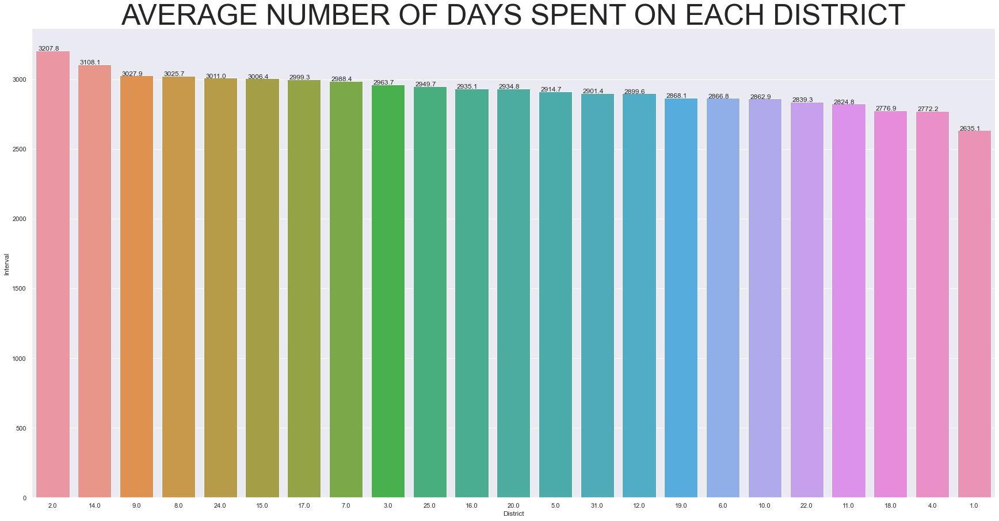

In [105]:
#Bar plot showing the average number of days spent on each crime type
order = dfFinal.groupby(["District"])["Interval"].mean().sort_values(ascending=False).index
ax = sns.barplot(x="District", y="Interval",ci = None, data=dfFinal, order=order)
ax.set_title('AVERAGE NUMBER OF DAYS SPENT ON EACH DISTRICT', fontsize=50)

sns.set(rc={'figure.figsize':(20,15)})
'''for p in ax.patches:
        ax.annotate('%{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+50))'''

for p in ax.patches:
   ax.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))


plt.savefig("Interval_xDistrict.jpg")
plt.show()

AttributeError: module 'plotly' has no attribute 'xticks'

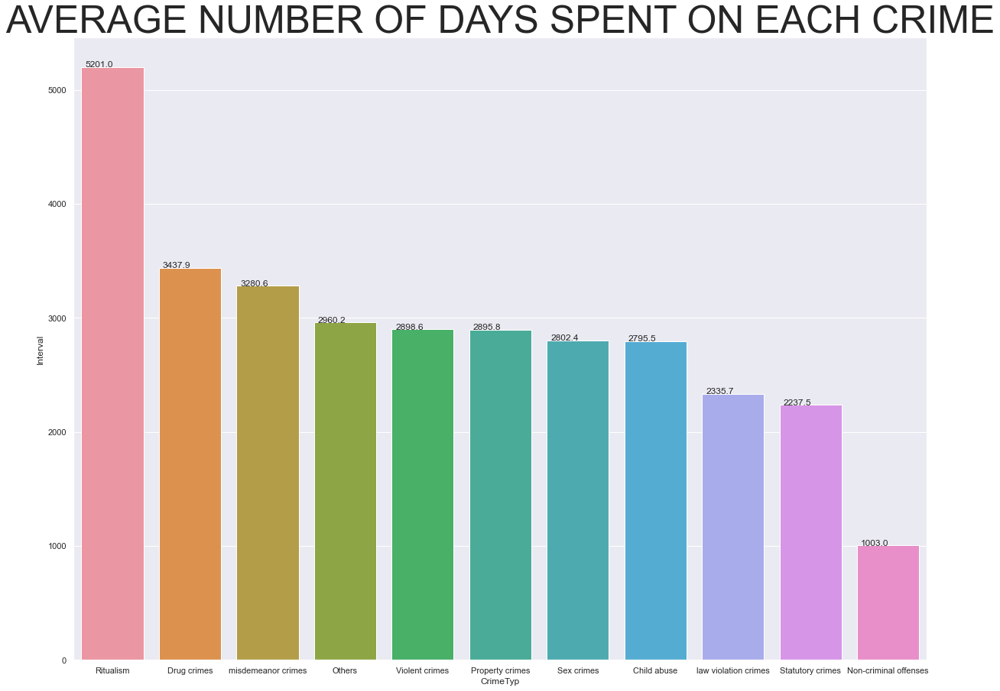

In [106]:
#Bar plot showing the average number of days spent on each crime type
order = dfFinal.groupby(["CrimeTyp"])["Interval"].mean().sort_values(ascending=False).index
ax = sns.barplot(x="CrimeTyp", y="Interval",ci = None, data=dfFinal, order=order)
ax.set_title('AVERAGE NUMBER OF DAYS SPENT ON EACH CRIME', fontsize=50)
sns.set(rc={'figure.figsize':(20,20)})
'''for p in ax.patches:
        ax.annotate('%{:.1f}'.format(p.get_height()), (p.get_x()+0.1, p.get_height()+50))'''

for p in ax.patches:
   ax.annotate('{:.1f}'.format(p.get_height()), (p.get_x()+0.05, p.get_height()+0.01))
plt.xticks(rotation=45)
plt.savefig("Interval_xCrimeTyp.jpg")
plt.show()

In [107]:
#With the code: 
dfFinal['Block'].value_counts().tolist
#The following blocks (with number of reported crimes) should be under more serious surveillance!.
'''001XX N STATE ST 51
100XX W OHARE ST 33 
008XX N MICHIGAN AVE 28 
076XX S CICERO AVE 25
063XX S DR MARTIN LUTHER KING JR DR 21
0000X W TERMINAL ST 19 
023XX S STATE ST 17 
001XX W 87TH ST 17 
0000X N STATE ST 17 
075XX S STONY ISLAND AVE 16 
064XX S DR MARTIN LUTHER KING JR DR 16 
005XX E BROWNING AVE 15 
0000X E GRAND AVE 15 
006XX N MICHIGAN AVE 15 
012XX S WABASH AVE 15 
0000X S STATE ST 14 
065XX S DR MARTIN LUTHER KING JR DR 13
023XX W MADISON ST 13
057XX S CICERO AVE 13
021XX E 87TH ST 13 
006XX N CLARK ST 13 
002XX W 87TH ST 12 
001XX W DIVISION ST 12
033XX N HALSTED ST 12 
039XX W VAN BUREN ST 12 
009XX W BELMONT AVE 12 
066XX S HALSTED ST 11 
086XX S COTTAGE GROVE AVE 11 
003XX N CENTRAL AVE 11 
005XX N MICHIGAN AVE 11 
011XX S CANAL ST 11 
040XX W LAKE ST 11 
015XX N MILWAUKEE AVE 11
017XX W HOWARD ST 11 
063XX S ASHLAND AVE 10 
006XX E GRAND AVE 10 
0000X W JACKSON BLVD 10
012XX N CLARK ST 10 
022XX S STATE ST 10 
012XX N LARRABEE ST 10 
012XX S ASHLAND AVE 10 
008XX N STATE ST 10 
048XX W NORTH AVE 10 
024XX S STATE ST 10 
0000X W DIVISION ST 10 
015XX S KEELER AVE 10
''' 
 


'001XX N STATE ST 51\n100XX W OHARE ST 33 \n008XX N MICHIGAN AVE 28 \n076XX S CICERO AVE 25\n063XX S DR MARTIN LUTHER KING JR DR 21\n0000X W TERMINAL ST 19 \n023XX S STATE ST 17 \n001XX W 87TH ST 17 \n0000X N STATE ST 17 \n075XX S STONY ISLAND AVE 16 \n064XX S DR MARTIN LUTHER KING JR DR 16 \n005XX E BROWNING AVE 15 \n0000X E GRAND AVE 15 \n006XX N MICHIGAN AVE 15 \n012XX S WABASH AVE 15 \n0000X S STATE ST 14 \n065XX S DR MARTIN LUTHER KING JR DR 13\n023XX W MADISON ST 13\n057XX S CICERO AVE 13\n021XX E 87TH ST 13 \n006XX N CLARK ST 13 \n002XX W 87TH ST 12 \n001XX W DIVISION ST 12\n033XX N HALSTED ST 12 \n039XX W VAN BUREN ST 12 \n009XX W BELMONT AVE 12 \n066XX S HALSTED ST 11 \n086XX S COTTAGE GROVE AVE 11 \n003XX N CENTRAL AVE 11 \n005XX N MICHIGAN AVE 11 \n011XX S CANAL ST 11 \n040XX W LAKE ST 11 \n015XX N MILWAUKEE AVE 11\n017XX W HOWARD ST 11 \n063XX S ASHLAND AVE 10 \n006XX E GRAND AVE 10 \n0000X W JACKSON BLVD 10\n012XX N CLARK ST 10 \n022XX S STATE ST 10 \n012XX N LARRABEE ST 1

In [91]:
'''Most common crimes are property, violent, drug, statutory and misdemeanor crimes. 
The police authority should prepare for these crimes 
in residences/apartments, sidewalks, on the streets, in stores all day round, 
in the mornings and nights (within the hours of 00:00 am till 11:59 am and from 17:00pm till 23:59 pm) 
and slightly lower crime rates on weekends 
(with the exception of violent crimes which is slightly higher on weekends). 
Drug crimes surveillance must increase at night. 

These crimes happen all month round and it’s at its peak in the months 
of May, June, July, August, September and October (for violent and property crimes). 
More crime surveillance must be made at the beginning of each year.

To arrest criminals, The police officials must target the following locations:
Residences/apartments, streets, sidewalks and in stores. More arrests were made on sidewalks and in stores. 
More attention should be focused or more frequent crime locations like in Residences/apartments and on the streets. 

More police officers need to be recruited (If they are lacking or more patrol units need to be designated)
to increase arrest rates from 26.5% to about 50% or even more. 
Arrest rate is beginning to diminish over the years. 
Whatever measures that were made in arresting criminals need to be revisited.

All drug criminals were arrested, more arrests need to be made for other more 
frequent crimes (property and violent). 

More arrests needed in the mornings when crime rate is higher other than at nights. 
Follow up investigation was made on much less frequent crimes like ‘Ritualism’ and ‘misdemeanor crimes’. 

More investigation time needs to be spent on violent and property crimes. 

Follow-up investigation is made on each district almost on the same frequency. 
Whereas, more time needs to be spent on the following districts 
with higher crime rates 8, 11, 6, 7, 4, 25, 9, 3, 12, 2, 19, 10, 18, 15, 5, 1 than on 22, 16, 24, 17, 20,  
and 31 with much lesser crime rates.


'''

'Most common crimes are property, violent, drug, statutory and misdemeanor crimes. \nThe police authority should prepare for these crimes in residences/apartments, sidewalks, on the streets, \nin stores all day round (with higher rates during the week) in the mornings and nights \n(within the hours of 00:00 am till 11:59 am and from 17:00pm till 23:59 pm) \nand lower crime rates on sundays (with the exception of violent crimes which is higher on weekends). \nDrug crimes surveillance can span from 00:00 am till 23:29 pm. These crimes happen all month round and it’s at its peak in the months of May, June July, August, September and October (for violent and property crimes). However, drug crimes were observed more at the beginning of the year.\n'